# Projet Data Science Livrable 1


GROUPE : 
- Ali RAMDANI
- Nariman FOUGHALI
- Meriem HAMOUMA
- Aissa HADJ ARAB


Ce Notebook contient les étapes necessaire a la realisation du premier liverable du projet Data Science, le but de ce liverable est de construir un model de deep learning 
permettant de classifier des images selon les classes données : 
- Painting
- Photo
- Schematics
- Sketch
- Text

# Etape 1 : importer les librairies necessaires

Ce code importe les bibliothèques suivantes:

- tensorflow: une bibliothèque de machine learning pour construire et entraîner des modèles de deep learning
- keras: une bibliothèque de réseaux de neurones de haut niveau pour tensorflow
- keras_tuner: une bibliothèque pour effectuer une recherche de hyperparamètres de modèles de deep learning avec keras
- matplotlib: une bibliothèque de visualisation de données en Python
- numpy: une bibliothèque de calcul scientifique en Python qui permet de travailler avec des tableaux et des matrices de données
- pandas: une bibliothèque de manipulation et analyse de données en Python
- pathlib: une bibliothèque de manipulation de chemins de fichiers en Python
- os: une bibliothèque de fonctions de système d'exploitation en Python
- imghdr: une bibliothèque de détection de types de fichiers image en Python
- PIL: une bibliothèque d'images en Python
- cv2: une bibliothèque de traitement d'images en Python
- itertools: une bibliothèque de fonctions d'itération en Python
- datetime: une bibliothèque de manipulation de dates et de temps en Python

In [2]:
import tensorflow as tf
from tensorflow import keras
import keras_tuner as kt

import matplotlib.pyplot as plt
import numpy as np
import pandas as pd

import pathlib
from pathlib import Path
import os

import imghdr
from PIL import Image
import cv2 

import itertools
import datetime

Etape 2 : Préparer l'envirronement de travail

Nous utiliserons la version 2.10.1 de TensorFlow et nous utilisons l'accéleration GPU affin d'ameliorer les performances de la machine lors de l'entrainement du model

In [3]:
# Use Python version : 3.8.8
# Use Tensorflow version : < 2.11.0
print("Tensorflow version : ", tf.__version__)

Tensorflow version :  2.10.1


'prepare_gpu_acceleration()' Cette fonction vérifie si le matériel GPU est disponible pour l'accélération des calculs tensorflow. Si le GPU est disponible, il affiche un message indiquant que le GPU est disponible et la liste des appareils GPU disponibles. Si le GPU n'est pas disponible, il affiche un message indiquant que le GPU n'est pas disponible et la liste des appareils disponibles. La fonction essaie également de configurer la croissance de la mémoire pour chaque GPU disponible, afin que l'ensemble de la mémoire du GPU soit utilisé lorsque cela est nécessaire.

In [4]:
def prepare_gpu_acceleration():
    gpus = tf.config.experimental.list_physical_devices('GPU')
    if gpus:
        print("GPU is AVAILABLE 🚀")
        print(tf.config.experimental.list_physical_devices('GPU'))
        try:
            for gpu in gpus:
                tf.config.experimental.set_memory_growth(gpu, True)
        except RuntimeError as e:
            print("An error occured while setting memory growth for GPU 💀")
            print(e)
    else:
        print("GPU is NOT AVAILABLE 🐌")
        print(tf.config.experimental.list_physical_devices())

prepare_gpu_acceleration()

GPU is AVAILABLE 🚀
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


Etape 3 : Préparer les données d'entrainement de validation et de test

Ce code définit deux variables: data_dir et data_set. La variable data_dir est initialisée avec une chaîne de caractères qui représente le nom du répertoire où se trouvent les données du dataset. La variable data_set est initialisée avec un objet de type pathlib.Path qui représente le chemin vers le répertoire de données du dataset. pathlib.Path est une classe de la bibliothèque pathlib qui permet de manipuler des chemins de fichiers de manière plus intuitive en Python.

In [5]:
#definir le chemin vers le répertoire recine du dataset
data_dir = "data"
data_set = pathlib.Path(data_dir)

Ce code définit une fonction file_counter qui compte le nombre de fichiers dans chaque répertoire du dataset. La fonction utilise la fonction os.walk pour parcourir récursivement tous les répertoires du dataset, en commençant par le répertoire racine spécifié par la variable data_dir. Pour chaque répertoire visité, la fonction vérifie si le répertoire contient des fichiers en utilisant la longueur de la liste files. Si le répertoire contient des fichiers, la fonction récupère le nom du répertoire (qui correspond au nom de la classe) et compte le nombre de fichiers dans le répertoire. Le résultat est enregistré dans un dictionnaire counter qui associe chaque nom de classe à un compte de fichiers.

La fonction file_counter est appelée et le résultat est stocké dans la variable counter. Le nombre total de fichiers dans le dataset est également affiché en utilisant la fonction glob de pathlib.Path. Enfin, le nombre de fichiers dans chaque répertoire est affiché en parcourant le dictionnaire counter et en imprimant chaque nom de classe et son compte de fichiers associé.

In [6]:
# Identifier le nombre de fichier dans le dataset
def file_counter():
    counter = {}
    for subdir, dirs, files in os.walk(data_dir):
        # si le repertoire est un répertoire de classe contient des images
        if len(files) > 0:
            # récuperer le nom de la classe
            class_name = os.path.basename(subdir)
            # compter le nombre d'images dans le dictionnaire
            count = len(files)
            # enregistrer le nombre d'images dans le dictionnaire
            counter[class_name] = count

    return counter


counter = file_counter()

print("Nombre de fichiers dans le dataset : ", len(list(data_set.glob('*/*'))))
for class_name, count in counter.items():
    print(f"{class_name} : {count}")


Nombre de fichiers dans le dataset :  40671
Painting : 9993
Photo : 9993
Schematics : 9279
Sketch : 1406
Text : 10000


Ce code définit deux fonctions: move_invalid_files et check_images. La fonction move_invalid_files prend en entrée un nom de fichier et un nom de sous-répertoire et déplace le fichier vers un répertoire appelé corrupted_images_dir s'il n'existe pas déjà.

La fonction check_images parcourt récursivement tous les répertoires du dataset en utilisant os.walk, en commençant par le répertoire racine spécifié par la variable data_dir. Pour chaque répertoire visité, la fonction vérifie si le répertoire contient des fichiers en utilisant la longueur de la liste files. Si le répertoire contient des fichiers, la fonction parcourt chaque fichier et vérifie si l'extension du fichier est dans la liste accepted_extensions. Si l'extension est acceptée, la fonction utilise la fonction imghdr.what pour vérifier si le fichier est une image valide. Si le fichier est une image valide, la fonction utilise la fonction tf.io.read_file de TensorFlow pour lire le contenu du fichier et la fonction tf.image.decode_image pour décoder l'image. Si l'image est décodée avec succès, cela signifie que l'image n'est pas corrompue et le compteur de fichiers valides est incrémenté. Si l'image ne peut pas être décodée, cela signifie que l'image est corrompue et le compteur d'images invalides est incrémenté. Si le fichier n'est pas une image valide ou si l'extension n'est pas acceptée, le compteur d'images invalides est également incrémenté.

La fonction check_images retourne trois résultats: le nombre d'images valides, le nombre d'images invalides et un dictionnaire qui associe chaque nom de classe à un dictionnaire qui compte le nombre d'images valides et invalides dans la classe.

In [7]:
# filtrer le dataset , deplacer les images corrumpu

accepted_extensions = [".png", ".jpg", ".jpeg", ".bmp"]

corrupted_images_dir = "corrupted"

# filtrer le dataset , deplacer les images corrumpu
def move_invalid_files(file, subdir):
    if not os.path.exists(corrupted_images_dir):
        os.mkdir(corrupted_images_dir)
    invalid_image_path = os.path.join(corrupted_images_dir, file)
    os.rename(os.path.join(subdir, file), invalid_image_path)


def check_images():
    valid_count = 0
    invalid_count = 0
    count_by_class = {}
    for subdir, dirs, files in os.walk(data_dir):
        # si le repertoire est un répertoire de classe contient des images
        if len(files) > 0:
            for file in files:
                # récuperer le nom de la classe
                class_name = os.path.basename(subdir)
                if class_name not in count_by_class:
                    count_by_class[class_name] = {"valid": 0, "invalid": 0}
                # vérifier si l'extension du fichier est accepté
                if Path(file).suffix.lower() in accepted_extensions:
                    # vérifier si le fichier est une image valide
                    if imghdr.what(os.path.join(subdir, file)) is not None:
                        # check si les images ne sont pas corrompues
                        try:
                            img_bytes = tf.io.read_file(os.path.join(subdir, file))
                            decoded_img = tf.image.decode_image(img_bytes)
                            valid_count += 1
                            count_by_class[class_name]["valid"] += 1
                        except tf.errors.InvalidArgumentError as e:
                            invalid_count += 1
                            count_by_class[class_name]["invalid"] += 1
                            move_invalid_files(file, subdir)
                    else:
                        invalid_count += 1
                        count_by_class[class_name]["invalid"] += 1
                        move_invalid_files(file, subdir)
                else:
                    invalid_count += 1
                    count_by_class[class_name]["invalid"] += 1
                    move_invalid_files(file, subdir)
    return valid_count, invalid_count, count_by_class


# 📢 Executer le code ci dessous une seule fois seulement !
# valid_count, invalid_count, count_by_class = check_images()
# print("🟢 valid images: ", valid_count)
# print("🔴 invalid count: ", invalid_count)
# for class_name, count in count_by_class.items():
#     print(class_name)
#     print(f"- {count['valid']} valid")
#     print(f"- {count['invalid']} invalid")


Ce code affiche une image au hasard du sous-répertoire Photo du dataset. La variable painting_images est initialisée avec une liste de tous les fichiers dans le sous-répertoire Photo en utilisant la fonction glob de pathlib.Path. La variable random_painting est initialisée avec un tableau de taille 1 contenant un fichier au hasard de la liste painting_images en utilisant la fonction np.random.choice de NumPy. Enfin, l'image est ouverte et affichée en utilisant la fonction Image.open de la bibliothèque PIL.

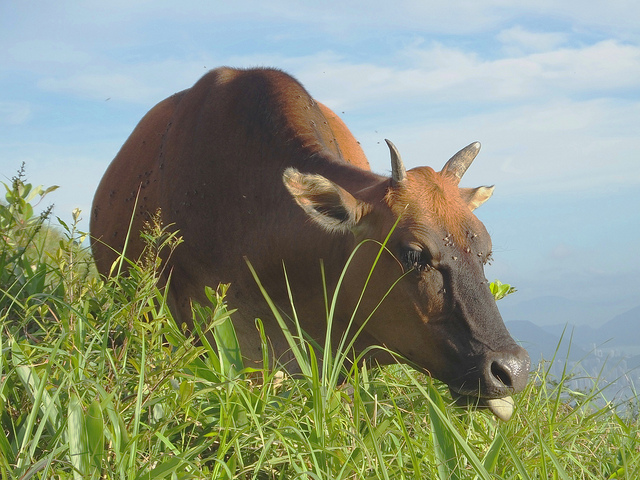

In [8]:
#afficher un echantillons du dataset
painting_images = list(data_set.glob('Photo/*'))
random_painting = np.random.choice(painting_images, 1)
Image.open(str(random_painting[0]))


Ce code définit plusieurs constantes qui seront utilisées dans le reste du code:

- BATCH_SIZE: le nombre d'images à inclure dans chaque lot lors de l'entraînement du modèle.
- IMG_H: la hauteur des images d'entrée du modèle.
- IMG_W: la largeur des images d'entrée du modèle.
- SEEDS: la graine aléatoire utilisée pour initialiser le générateur de nombres aléatoires.
- VALIDATION_SPLIT: le pourcentage de données à utiliser pour la validation lors de l'entraînement du modèle.

In [36]:
BATCH_SIZE = 64
IMG_H = 128
IMG_W = 128
SEEDS = 10
VALIDATION_SPLIT = 0.2

Ce code prépare le dataset en utilisant la fonction tf.keras.utils.image_dataset_from_directory. Cette fonction prend en entrée un répertoire de données (spécifié par la variable data_set) et génère un objet tf.data.Dataset qui peut être utilisé pour entraîner un modèle de réseau de neurones. La fonction prend en compte le paramètre validation_split pour séparer les données en deux sous-ensembles: un ensemble d'entraînement et un ensemble de validation. Le sous-ensemble training est utilisé pour entraîner le modèle et le sous-ensemble validation est utilisé pour évaluer le modèle pendant l'entraînement. La fonction utilise également la graine aléatoire spécifiée par seed pour mélanger les données de manière aléatoire. Les images sont redimensionnées à la taille spécifiée par image_size et groupées en lots de taille batch_size pour être utilisées lors de l'entraînement du modèle.

Le code crée deux objets tf.data.Dataset: train_set pour l'ensemble d'entraînement et val_set pour l'ensemble de validation. Ces objets peuvent être utilisés pour entraîner et évaluer un modèle de réseau de neurones sur le dataset.

In [37]:
# preparer le dataset
 
train_set = tf.keras.utils.image_dataset_from_directory(
    data_set,
    validation_split=VALIDATION_SPLIT,
    subset="training",
    seed=SEEDS,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    shuffle=True
)

val_set = tf.keras.utils.image_dataset_from_directory(
    data_set,
    validation_split=VALIDATION_SPLIT,
    subset="validation",
    seed=SEEDS,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    shuffle=True
)


Found 40671 files belonging to 5 classes.
Using 32537 files for training.
Found 40671 files belonging to 5 classes.
Using 8134 files for validation.


Ce code sépare l'ensemble de validation en deux sous-ensembles: un ensemble de test et un ensemble de validation. La fonction cardinality de tf.data.experimental est utilisée pour déterminer le nombre de lots dans l'ensemble de validation. Le nombre total de lots dans l'ensemble de validation est divisé par 5 et le sous-ensemble de test est obtenu en prenant les lots du début de l'ensemble de validation à l'aide de la fonction take. Le sous-ensemble de validation est obtenu en sautant ces lots à l'aide de la fonction skip.

Le nombre de lots dans chaque ensemble (test, validation et entraînement) est affiché pour vérifier que les ensembles ont été séparés correctement.

In [38]:
val_batches = tf.data.experimental.cardinality(val_set)
test_set = val_set.take(val_batches // 5)
val_set = val_set.skip(val_batches // 5)

print('Number of validation batches: %d' % tf.data.experimental.cardinality(val_set))
print('Number of test batches: %d' % tf.data.experimental.cardinality(test_set))
print('Number of train batches: %d' % tf.data.experimental.cardinality(train_set))

Number of validation batches: 103
Number of test batches: 25
Number of train batches: 509


Ce code récupère les noms de classe du dataset en utilisant la propriété class_names de l'objet tf.data.Dataset créé précédemment. Les noms de classe sont affichés pour vérifier qu'ils ont été correctement extraits du dataset.

In [39]:
# récupérer les noms des classes du dataset
class_names = train_set.class_names
print(f"🎭 Categories : {class_names}")

🎭 Categories : ['Painting', 'Photo', 'Schematics', 'Sketch', 'Text']


Ce code affiche un échantillon de 25 images prises au hasard de l'ensemble d'entraînement en utilisant la fonction take de tf.data.Dataset. Chaque image est affichée avec son nom de classe correspondant sous forme de titre. La fonction plt.imshow de Matplotlib est utilisée pour afficher chaque image et la fonction plt.title est utilisée pour afficher le nom de classe. La fonction plt.axis est utilisée pour masquer les axes du graphique.

Ce code peut être utilisé pour vérifier visuellement que le dataset a été chargé correctement et que les images et les étiquettes sont associées de manière cohérente.

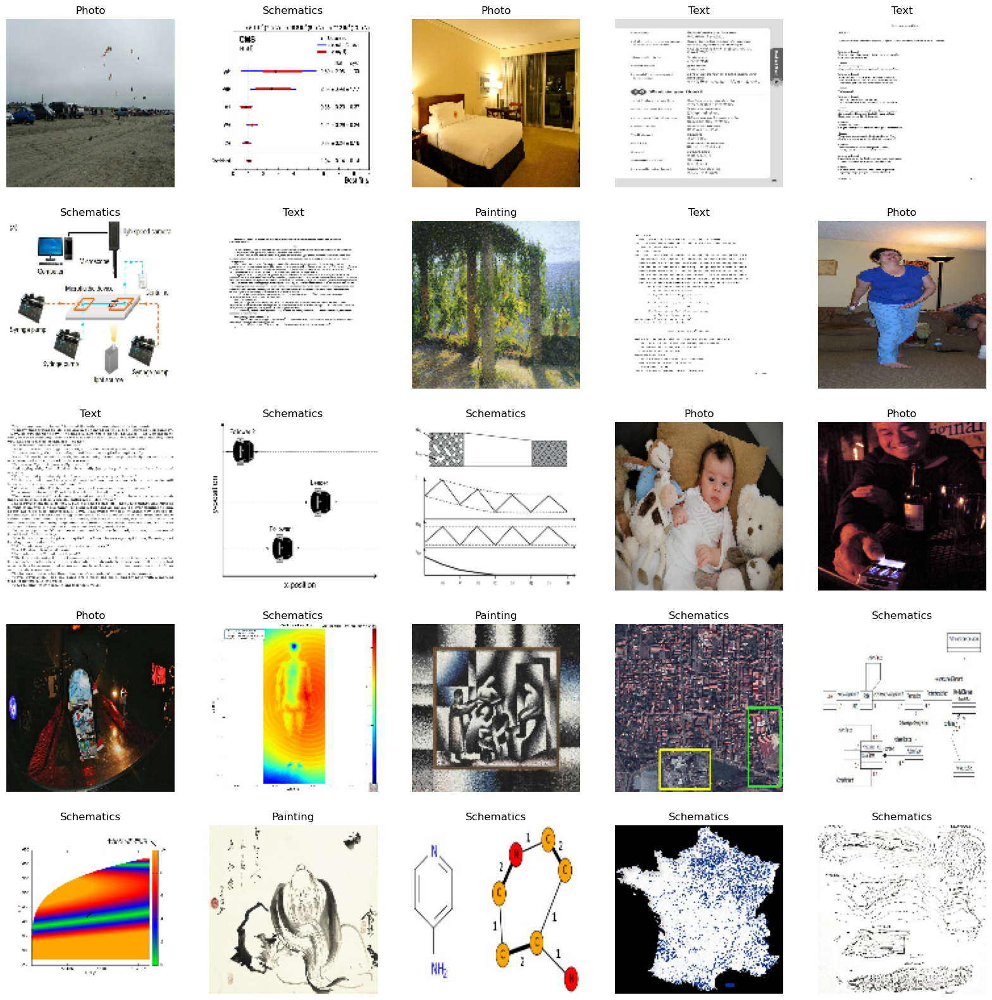

In [40]:
plt.figure(figsize=(20, 20))
for images, labels in train_set.take(1):
  for i in range(25):
    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.title(class_names[labels[i]])
    plt.axis("off")

Ce code est similaire au code précédent, mais affiche également une barre de couleurs à côté de chaque image. La fonction plt.colorbar de Matplotlib est utilisée pour afficher la barre de couleurs. Cela peut être utile pour visualiser la distribution des valeurs de pixels dans chaque image.

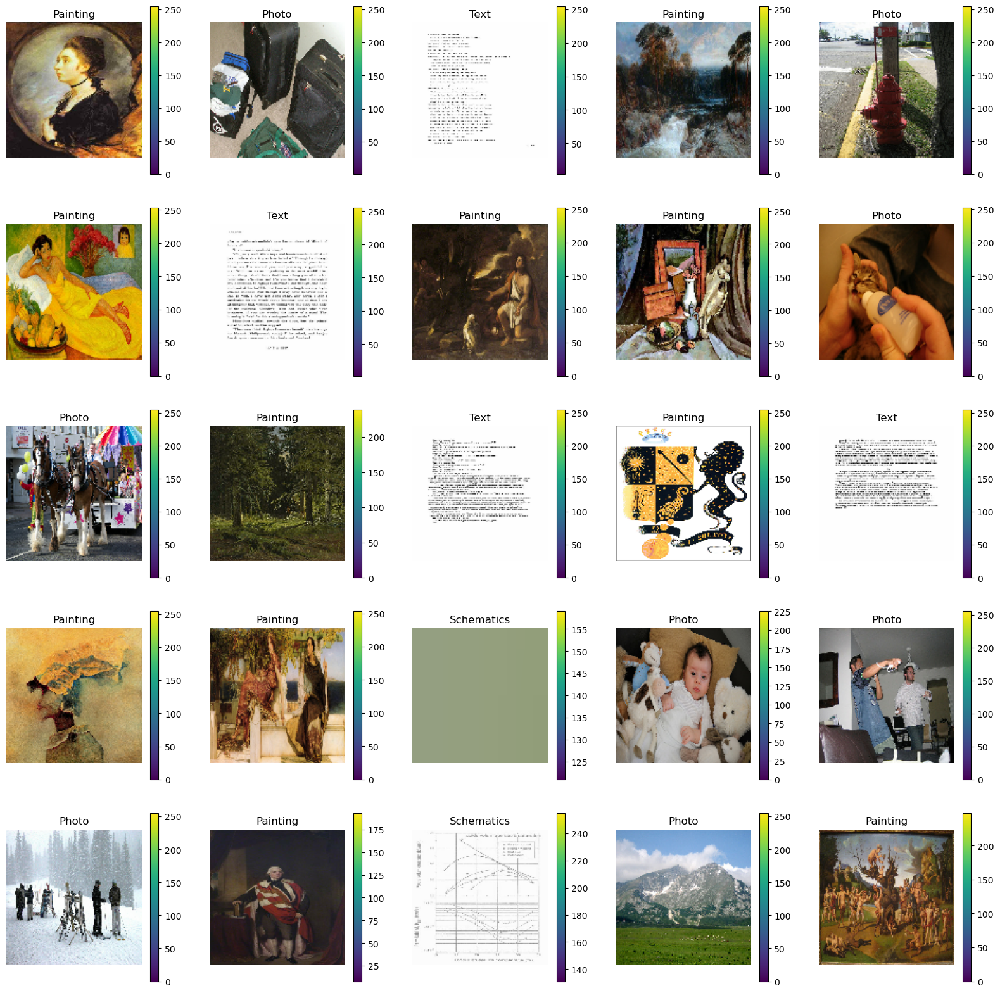

In [41]:
# afficher un echantillon du dataset
plt.figure(figsize=(20, 20))
for images, labels in train_set.take(1):
  for i in range(25):
    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(images[i].numpy().astype("uint8"))
    plt.colorbar()
    plt.title(class_names[labels[i]])
    plt.axis("off")


Ce code imprime le type de l'objet train_set, qui devrait être tf.data.Dataset. Il utilise également l'itérateur de l'objet train_set pour obtenir le prochain lot d'images et d'étiquettes, puis imprime leurs formes.

Le type de l'objet train_set peut être utile pour vérifier que l'objet est bien un objet tf.data.Dataset. Les formes des images et des étiquettes peuvent être utiles pour vérifier que les dimensions sont correctes et que les données sont prêtes à être utilisées pour entraîner un modèle de réseau de neurones.

In [42]:
print(type(train_set))
images , labels = iter(train_set).next()
print(f"🖼️ images shape : {images.shape}")
print(f"🎟️ labels shape{labels.shape}")

<class 'tensorflow.python.data.ops.dataset_ops.BatchDataset'>
🖼️ images shape : (64, 128, 128, 3)
🎟️ labels shape(64,)


Ce code définit plusieurs constantes qui seront utilisées dans le reste du code:

- NUM_CLASSES: le nombre de classes dans le dataset. Cette valeur est déterminée en comptant le nombre d'éléments dans la liste class_names.
- NO_EPOCHS: le nombre d'époques à utiliser pour entraîner le modèle. Une époque correspond à une passe complète sur l'ensemble d'entraînement.
- SHUFFLE: la taille du tampon de mélange utilisé lors de l'entraînement du modèle.
- RESCALING: le facteur de rééchantillonnage à appliquer aux images d'entrée du modèle.
- RANDOM_ROTATION: l'angle maximum de rotation aléatoire à appliquer aux images d'entraînement.
- RANDOM_ZOOM: le facteur de zoom maximum aléatoire à appliquer aux images d'entraînement.
- RANDOM_FILP: le type de flip aléatoire à appliquer aux images d'entraînement.
- LEARING_RATE: le taux d'apprentissage utilisé pour mettre à jour les poids du modèle pendant l'entraînement. Un taux d'apprentissage plus élevé peut entraîner une convergence plus rapide, mais peut également entraîner un surapprentissage ou un comportement instable du modèle. Un taux d'apprentissage plus faible peut entraîner une convergence plus lente, mais peut également améliorer la robustesse et la généralisation du modèle.

In [44]:
NUM_CLASSES = len(class_names)
NO_EPOCHS = 50
SHUFFLE = 1000
RESCALING = 1./255
RANDOM_ROTATION = 0.2
RANDOM_ZOOM = 0.2
RANDOM_FILP = "horizontal_and_vertical"
LEARING_RATE = 0.015

Ce code modifie l'ensemble d'entraînement, l'ensemble de validation et l'ensemble de test en utilisant différentes fonctions de tf.data.Dataset pour améliorer les performances de l'entraînement du modèle.

- cache: cette fonction enregistre les données dans la mémoire au fur et à mesure qu'elles sont chargées à partir du disque, ce qui peut améliorer les performances en réduisant le temps de chargement des données à chaque époque.
- shuffle: cette fonction mélange aléatoirement les données d'entraînement en utilisant un tampon de mélange de taille donnée. Cela peut aider à prévenir l'overfitting en empêchant le modèle de voir toujours les mêmes données dans le même ordre.
- prefetch: cette fonction prétraite les données en arrière-plan pendant que le modèle est en train de s'entraîner. Cela peut améliorer les performances en réduisant les temps d'attente pendant l'entraînement.
La constante AUTOTUNE est définie par TensorFlow et indique au système de choisir automatiquement la meilleure valeur pour le paramètre buffer_size.

In [45]:
# cache conserve les images en mémoire après leur chargement hors disque au cours de la première Epoch
# prefetch chevauche le prétraitement des données et l'exécution du modèle pendant la formation.
# eviter overfitting et augmenter la vitesse d'entrainement du modele
AUTOTUNE = tf.data.AUTOTUNE
train_set = train_set.cache().shuffle(SHUFFLE).prefetch(buffer_size=AUTOTUNE)
val_set = val_set.cache().prefetch(buffer_size=AUTOTUNE)
test_set = test_set.cache().prefetch(buffer_size=AUTOTUNE)


Ce code crée un objet Sequential de TensorFlow qui définit une série de couches de traitement de données à appliquer aux données d'entraînement. Ces couches effectuent une augmentation de données aléatoire sur les images d'entraînement afin de diversifier l'ensemble de données et d'aider à prévenir l'overfitting.

Plus précisément, ces couches effectuent les opérations suivantes:

- RandomFlip: cette couche effectue un flip aléatoire des images en utilisant le paramètre RANDOM_FILP.
- RandomRotation: cette couche effectue une rotation aléatoire des images en utilisant le paramètre RANDOM_ROTATION.
- RandomZoom: cette couche effectue un zoom aléatoire des images en utilisant le paramètre RANDOM_ZOOM.

In [18]:
data_augmentation = tf.keras.Sequential([
  tf.keras.layers.RandomFlip(RANDOM_FILP),
  tf.keras.layers.RandomRotation(RANDOM_ROTATION),
  tf.keras.layers.RandomZoom(RANDOM_ZOOM),
])

Ce code affiche un exemple de l'effet de l'augmentation de données sur une image unique.

Tout d'abord, il récupère une image unique de l'ensemble d'entraînement et la stocke dans la variable first_image. Ensuite, il utilise une boucle pour appliquer l'objet data_augmentation (qui contient les couches de traitement de données décrites ci-dessus) à first_image neuf fois de suite et affiche le résultat de chaque traitement.

Cela permet de voir comment l'augmentation de données peut altérer l'apparence de l'image d'origine de différentes manières, telles que la rotation, le flip et le zoom. Cela peut être utile pour s'assurer que l'augmentation de données est configurée correctement et ne produit pas de résultats inattendus ou indésirables.

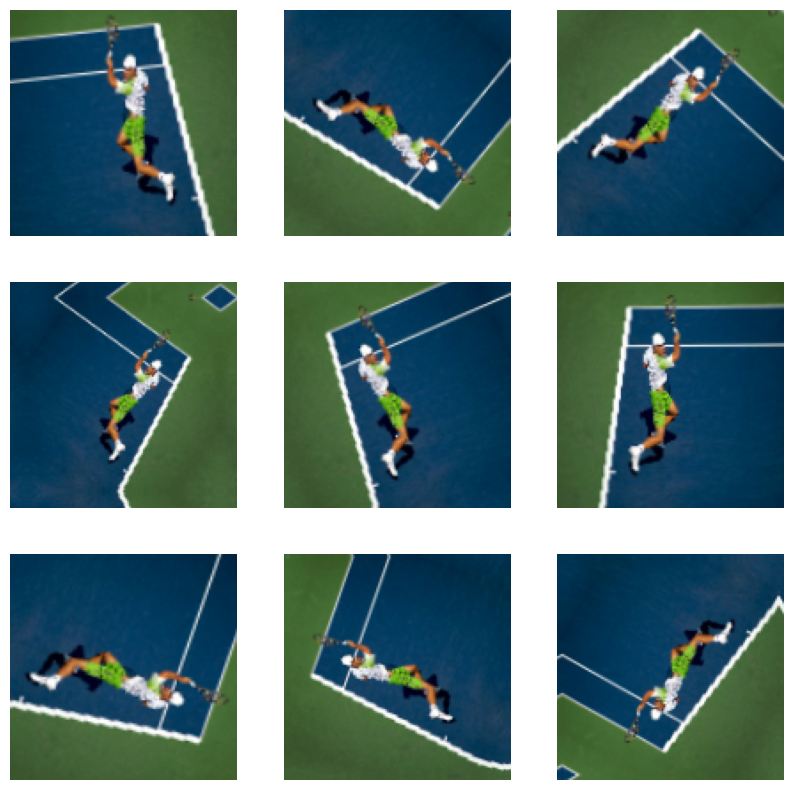

In [19]:
for image, _ in train_set.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(9):
    ax = plt.subplot(3, 3, i + 1)
    aug_image = data_augmentation(tf.expand_dims(first_image, 0))
    plt.imshow(aug_image[0] / 255)
    plt.axis('off')

Ce code crée un objet Sequential de TensorFlow qui définit une série de couches de traitement de données à appliquer aux données d'entraînement et de validation. Ces couches effectuent une normalisation des données pour améliorer la convergence du modèle pendant l'entraînement.

Plus précisément, cette séquence de couches effectue une seule opération:

- Rescaling: cette couche effectue une ré-échelle des données en divisant chaque pixel par 255 (la valeur maximale possible d'un pixel en 8 bits). Cela ramène les valeurs des pixels dans l'intervalle [0, 1], ce qui peut être plus facile pour le modèle à traiter et à converger.

- Resizing: La couche Resizing de TensorFlow permet de redimensionner les images en utilisant une méthode de redimensionnement spécifiée. Par exemple, vous pouvez utiliser cette couche pour redimensionner toutes les images dans un jeu de données à une hauteur et une largeur spécifiques (par exemple, 128x128).

In [20]:
normalization_layer = tf.keras.Sequential([
    tf.keras.layers.Resizing(IMG_H, IMG_W),
    tf.keras.layers.Rescaling(RESCALING)
])

Ce code affiche une image du jeu de données d'entraînement après avoir été traitée par la couche de normalisation. La couche de normalisation divise chaque pixel de l'image par 255, ce qui ramène les valeurs de pixel dans l'intervalle [0, 1].

Le code imprime également les valeurs minimale et maximale de l'image normalisée, qui devraient être respectivement inférieures à 1 et supérieures à 0. Cela confirme que la couche de normalisation fonctionne comme prévu et que les valeurs des pixels ont été mises à l'échelle correctement.

🔼 image min : 0.0
🔽 image max : 1.0


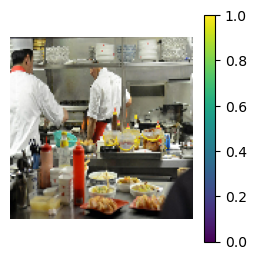

In [22]:
for image, _ in train_set.take(1):
  plt.figure(figsize=(10, 10))
  first_image = image[0]
  for i in range(1):
    ax = plt.subplot(3, 3, i + 1)
    normalized_image = normalization_layer(tf.expand_dims(first_image, 0))

    plt.imshow(normalized_image[0])
    plt.colorbar()
    plt.axis('off')

print(f"🔼 image min : {normalized_image[0].numpy().min()}")
print(f"🔽 image max : {normalized_image[0].numpy().max()}")

Ce code définit un modèle de réseau de neurones convolutionnel (CNN) pour la classification d'images. Le modèle prend en entrée une image de taille (128, 128, 3) et utilise une série de couches de convolution, de max pooling et de normalisation pour extraire des caractéristiques de l'image. Ces caractéristiques sont ensuite flatties et utilisées comme entrée dans une série de couches densément connectées qui effectuent la classification finale.

Le modèle utilise également plusieurs couches de dropout et de régularisation pour éviter l'overfitting.

In [79]:
model = tf.keras.Sequential([

    tf.keras.Input(shape=(IMG_H, IMG_W, 3)),

    normalization_layer,
    data_augmentation,


    tf.keras.layers.Conv2D(
        filters=128,
        kernel_size=(11,11) ,
        strides=(4,4),
        activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D(pool_size=(2,2)),

    tf.keras.layers.Conv2D(
        filters=256,
        kernel_size=(5,5),
        strides=(1,1),
        activation='relu'),
    tf.keras.layers.BatchNormalization(),
    tf.keras.layers.MaxPooling2D(pool_size=(3,3)),
   
    tf.keras.layers.Conv2D(
        filters=256,
        kernel_size=(3,3),
        strides=(1,1),
        activation='relu',
        padding='same'),
    tf.keras.layers.BatchNormalization(), 

    tf.keras.layers.Conv2D(
        filters=256,
        kernel_size=(1,1),
        strides=(1,1),
        activation='relu',
        padding='same'),
    tf.keras.layers.BatchNormalization(), 

    tf.keras.layers.Conv2D(
        filters=256,
        kernel_size=(1,1),
        strides=(1,1),
        activation='relu',
        padding='same'),
    tf.keras.layers.BatchNormalization(), 
    tf.keras.layers.MaxPooling2D(pool_size=(2,2)),

    tf.keras.layers.Flatten(),

    tf.keras.layers.Dense(1024, activation='relu',
                          kernel_regularizer=tf.keras.regularizers.l2(0.001)),
    tf.keras.layers.Dropout(0.5),

    tf.keras.layers.Dense(1024, activation='relu',
                          kernel_regularizer=tf.keras.regularizers.l2(0.001)),
    tf.keras.layers.Dropout(0.5),


    tf.keras.layers.Dense(NUM_CLASSES)
])


Ce code compile le modèle en spécifiant l'optimiseur à utiliser (Adam), la fonction de perte (SparseCategoricalCrossentropy) et les métriques à utiliser pour évaluer le modèle (accuracy). La fonction de perte mesure l'erreur du modèle lors de sa prédiction et l'optimiseur utilise cette mesure pour mettre à jour les poids du modèle afin de réduire l'erreur. Les métriques sont utilisées pour évaluer la performance du modèle sur les données de test.





In [80]:
# compiler le model optimizer=keras.optimizers.Adam(learning_rate=0.00015)
model.compile(
    optimizer=tf.keras.optimizers.Adam(learning_rate=LEARING_RATE),
    loss=tf.keras.losses.SparseCategoricalCrossentropy(
        from_logits=True
    ),
    metrics=['accuracy']
)


Cette ligne de code affiche un résumé du modèle de data augmentation. Le modèle de data augmentation est un séquentiel de couches qui effectue différentes opérations de traitement des données sur les images d'entrée. Ces opérations comprennent la rotation aléatoire, le flip aléatoire et le zoom aléatoire. Le résumé affiche le nombre de paramètres dans chaque couche et la taille de l'input et de l'output pour chaque couche.





In [81]:
data_augmentation.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 random_flip (RandomFlip)    (None, 128, 128, 3)       0         
                                                                 
 random_rotation (RandomRota  (None, 128, 128, 3)      0         
 tion)                                                           
                                                                 
 random_zoom (RandomZoom)    (None, 128, 128, 3)       0         
                                                                 
Total params: 0
Trainable params: 0
Non-trainable params: 0
_________________________________________________________________


Cette ligne de code affiche un résumé du modèle de normalisation. Le modèle de normalisation est un séquentiel de couches qui effectue une normalisation sur les images d'entrée en les redimensionnant et en les rééchelonnant. Le résumé affiche le nombre de paramètres dans chaque couche et la taille de l'input et de l'output pour chaque couche.





In [82]:
normalization_layer.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 resizing (Resizing)         (None, 128, 128, 3)       0         
                                                                 
 rescaling (Rescaling)       (None, 128, 128, 3)       0         
                                                                 
Total params: 0
Trainable params: 0
Non-trainable params: 0
_________________________________________________________________


Cette ligne de code affiche un résumé du modèle de classification d'images. Le modèle comprend plusieurs couches de convolution et de max-pooling qui extraient des caractéristiques des images, suivies de couches de mise à plat et de densité qui combinent ces caractéristiques pour prédire la classe de l'image. Le résumé affiche le nombre de paramètres dans chaque couche, la forme de l'input et de l'output pour chaque couche, ainsi que le nombre total de paramètres dans le modèle.





In [83]:
model.summary()

Model: "sequential_7"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_1 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 sequential (Sequential)     (None, 128, 128, 3)       0         
                                                                 
 conv2d_16 (Conv2D)          (None, 30, 30, 128)       46592     
                                                                 
 batch_normalization (BatchN  (None, 30, 30, 128)      512       
 ormalization)                                                   
                                                                 
 max_pooling2d_16 (MaxPoolin  (None, 15, 15, 128)      0         
 g2D)                                                            
                                                                 
 conv2d_17 (Conv2D)          (None, 11, 11, 256)      

Voici un aperçu de notre modèle :

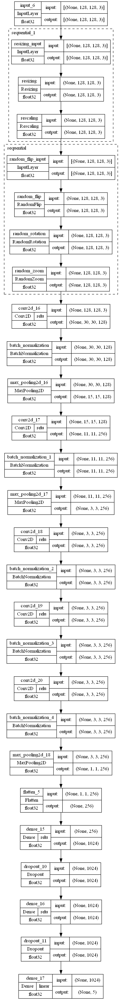

In [84]:
schema_file = "architecture/model_CNN_multiclass.png"
 
tf.keras.utils.plot_model(
    model,
    to_file=schema_file,
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True
)

Le code ci-dessus définit les répertoires où seront enregistrés le modèle entraîné et les journaux de la formation. Le modèle sera enregistré dans le répertoire "models" avec un nom de fichier qui inclut la date et l'heure de sa création. Les journaux de formation seront enregistrés dans le répertoire "logs" avec un nom de répertoire qui inclut la date et l'heure de la formation.

In [85]:
# Definition de la validation croisée
models_dir = 'models/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + '/' + 'model.h5'
logs_dir = "logs/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")


Ce code définit un tableau de "callbacks" pour être utilisé lors de l'entraînement du modèle.

Le premier "callback" enregistre les données de suivi dans un répertoire TensorBoard, ce qui peut être utile pour visualiser l'évolution des métriques au fil du temps et identifier des tendances ou des comportements étranges.

Le deuxième "callback" enregistre le meilleur modèle au fil du temps, en fonction de la métrique de performance spécifiée (ici, la perte de validation).

Le troisième "callback" arrête l'entraînement prématurément si la perte de validation ne s'améliore pas après un certain nombre d'épochs (ici, 5). Cela peut être utile pour éviter de sur-entraîner le modèle et de surapprendre les données d'entraînement.

In [86]:
callbacks = [
    tf.keras.callbacks.TensorBoard(log_dir=logs_dir , histogram_freq=1),
    tf.keras.callbacks.ModelCheckpoint(models_dir, verbose=1, save_best_only=True),
    tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, verbose=1, mode='auto') , 
]

The fit() method is used to train the model. It takes in the following arguments:

- train_set: The training data, in the form of a tf.data dataset.
- epochs: The number of epochs to train for. An epoch is a complete pass through the training data.
- validation_data: The validation data, in the form of a tf.data dataset. The model will evaluate its performance on this data at the end of each epoch.
- verbose: Controls the amount of information that is printed to the console during training. A value of 1 will print progress bar and epoch information.
- callbacks: A list of tf.keras.callbacks objects that will be called during training. You can use callbacks to get a view on internal states and statistics of the model during training.

In [87]:
hist = model.fit(
    train_set,
    epochs=NO_EPOCHS,
    validation_data=val_set,
    verbose=1,
    callbacks=callbacks
)

Epoch 1/50
509/509 [==============================] - ETA: 0s - loss: 2.6808 - accuracy: 0.4969
Epoch 1: val_loss improved from inf to 1.16371, saving model to models/20230107-055035\model.h5
509/509 [==============================] - 310s 602ms/step - loss: 2.6808 - accuracy: 0.4969 - val_loss: 1.1637 - val_accuracy: 0.5465
Epoch 2/50
509/509 [==============================] - ETA: 0s - loss: 0.9486 - accuracy: 0.6107
Epoch 2: val_loss did not improve from 1.16371
509/509 [==============================] - 305s 600ms/step - loss: 0.9486 - accuracy: 0.6107 - val_loss: 1.6008 - val_accuracy: 0.4207
Epoch 3/50
509/509 [==============================] - ETA: 0s - loss: 0.8362 - accuracy: 0.6333
Epoch 3: val_loss did not improve from 1.16371
509/509 [==============================] - 304s 597ms/step - loss: 0.8362 - accuracy: 0.6333 - val_loss: 1.6311 - val_accuracy: 0.4371
Epoch 4/50
509/509 [==============================] - ETA: 0s - loss: 0.7781 - accuracy: 0.6532
Epoch 4: val_loss imp

Ce code permet de visualiser l'évolution de l'accuracy et de la loss du modèle pendant l'entraînement et la validation. Le modèle est entraîné sur un jeu de données d'entraînement et évalué sur un jeu de données de validation.

La figure comporte deux sous-graphiques, l'un pour l'accuracy et l'autre pour la loss. Pour chaque graphique, il y a deux courbes tracées: une pour l'accuracy ou la loss pendant l'entraînement et une autre pour l'accuracy ou la loss pendant la validation.

Le but de cette visualisation est de vérifier si le modèle est en train de surapprendre (overfitting). Si l'accuracy pendant l'entraînement continue d'augmenter tandis que l'accuracy pendant la validation diminue, cela signifie que le modèle est en train de surapprendre. Dans ce cas, il faut essayer de régulariser le modèle pour réduire l'overfitting.

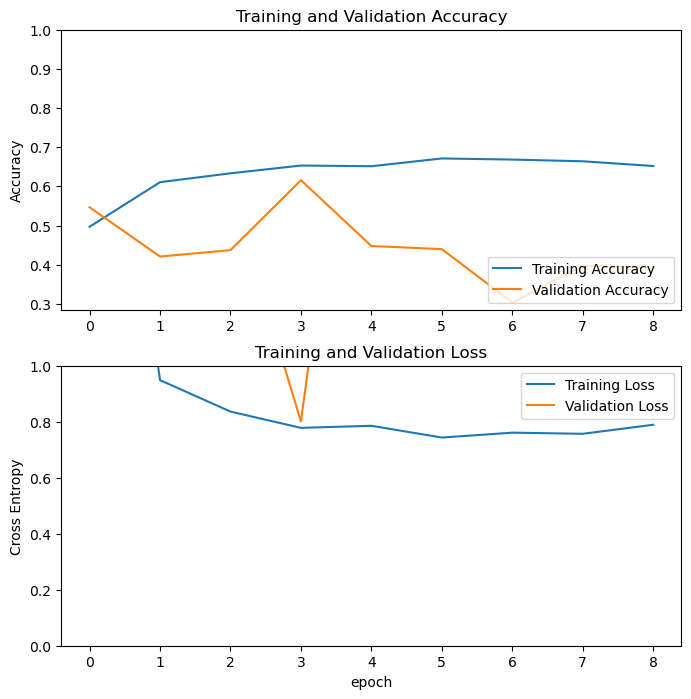

In [88]:
acc = hist.history['accuracy']
val_acc = hist.history['val_accuracy']

loss = hist.history['loss']
val_loss = hist.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

Le code ci-dessus permet de calculer la perte (loss) et la précision (accuracy) du modèle sur l'ensemble de validation. La perte est une mesure de l'erreur du modèle, tandis que la précision mesure à quel point les prédictions du modèle correspondent aux valeurs réelles. La fonction "evaluate" calcule ces métriques en utilisant l'ensemble de validation comme données d'entrée. Le paramètre "verbose" détermine si le progrès de l'évaluation doit être affiché. Enfin, les valeurs de perte et de précision sont imprimées à l'écran.





In [31]:
loss, acc = model.evaluate(val_set, verbose=1)

print("initial loss: {:.2f}".format(loss))
print("initial accuracy: {:.2f}".format(acc))

204/204 [==============================] - 6s 29ms/step - loss: 0.7864 - accuracy: 0.7630
initial loss: 0.79
initial accuracy: 0.76


Ce code utilise le modèle de classification précédemment entraîné pour prédire les étiquettes de classes sur un petit échantillon d'images de test. Pour chaque image, il affiche l'image elle-même, l'étiquette de classe prédite et la probabilité associée à la prédiction. Si la prédiction est correcte, le titre de l'image sera affiché en bleu, sinon en rouge.





1/1 [==============================] - 1s 840ms/step
Labels:  [2 4 2 2 2 4 2 4 4 1 4 2 0 0 1 0 0 1 2 4 1 0 0 4 1 4 4 1 0 0 2 4]
Predicted labels:  [2 2 0 2 2 4 2 4 2 1 4 2 2 0 1 0 0 0 2 2 1 1 1 4 1 2 4 1 0 0 2 4]


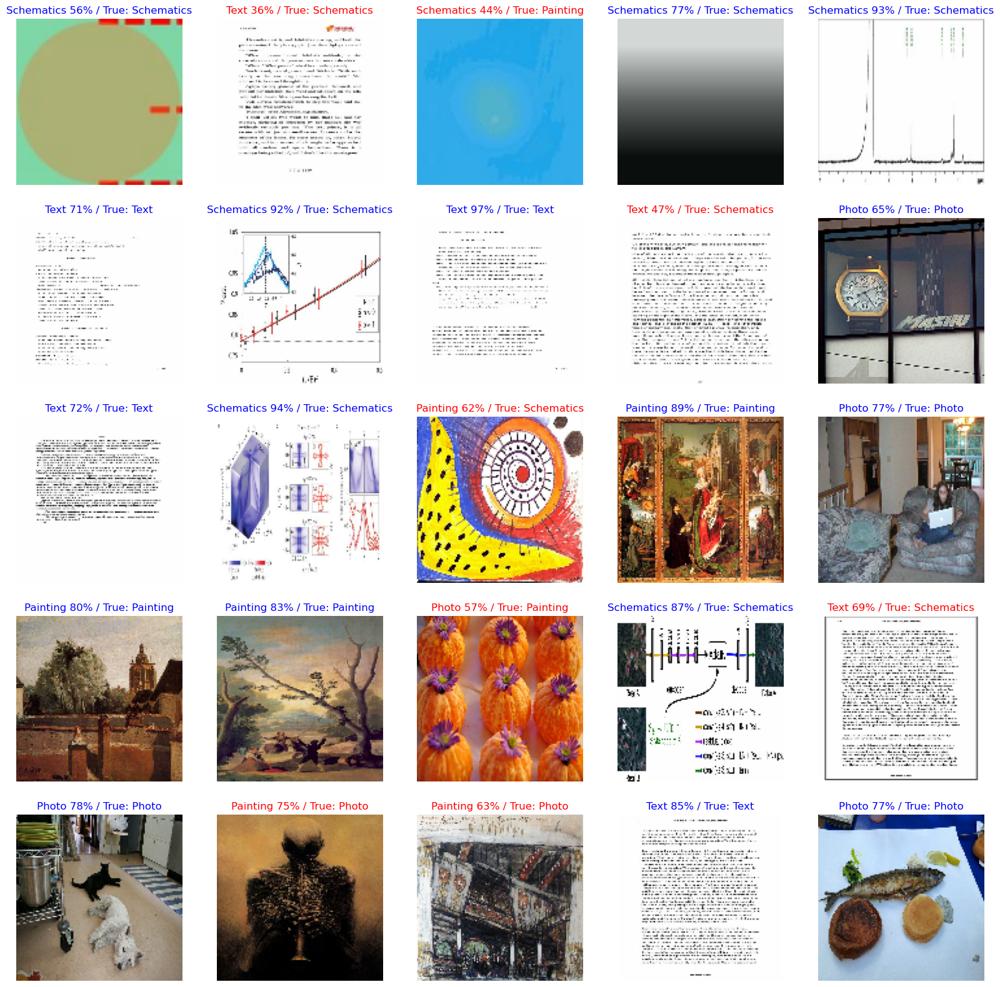

In [32]:
image_batch, label_batch = test_set.as_numpy_iterator().next()

predictions = model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)


print("Labels: ", label_batch)
print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    label = label_batch[i]
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if predicted_label == label else "red"

    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)
    plt.title("{} {}% / True: {}".format(class_names[label],
              int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


Ce code charge un modèle précédemment entraîné et enregistré dans le répertoire models_dir, puis l'évalue sur l'ensemble de test test_set en utilisant la méthode evaluate. La méthode evaluate retourne une perte et une précision pour l'ensemble de test. Ces résultats sont imprimés à l'aide de la commande print.





In [33]:
best_model = tf.keras.models.load_model(models_dir)
# evaluer le model sur les données de test avec `evaluate`
print("Evaluate on test data")
results = best_model.evaluate(test_set, batch_size=128)
print("test loss, test acc:", results)

Evaluate on test data
51/51 [==============================] - 3s 48ms/step - loss: 0.8010 - accuracy: 0.7157
test loss, test acc: [0.8010485172271729, 0.7156862616539001]


Ce code charge le meilleur modèle enregistré dans le répertoire models_dir, l'évalue sur l'ensemble de données de test et affiche les prédictions du modèle pour une sélection d'images de l'ensemble de données de test. Pour chaque image, le code affiche l'étiquette de classe réelle et la prédiction du modèle, ainsi que la probabilité associée à la prédiction. La couleur du titre de chaque image est bleue si la prédiction du modèle est correcte et rouge si elle est incorrecte.





1/1 [==============================] - 0s 86ms/step
Labels:  [0 0 2 0 1 4 0 1 2 4 2 1 2 4 0 4 2 4 2 1 2 0 4 4 0 0 0 0 0 2 0 2]
Predicted labels:  [1 4 2 1 1 4 1 1 4 4 2 1 2 4 0 4 2 4 1 1 2 0 4 4 1 1 1 1 1 4 0 2]


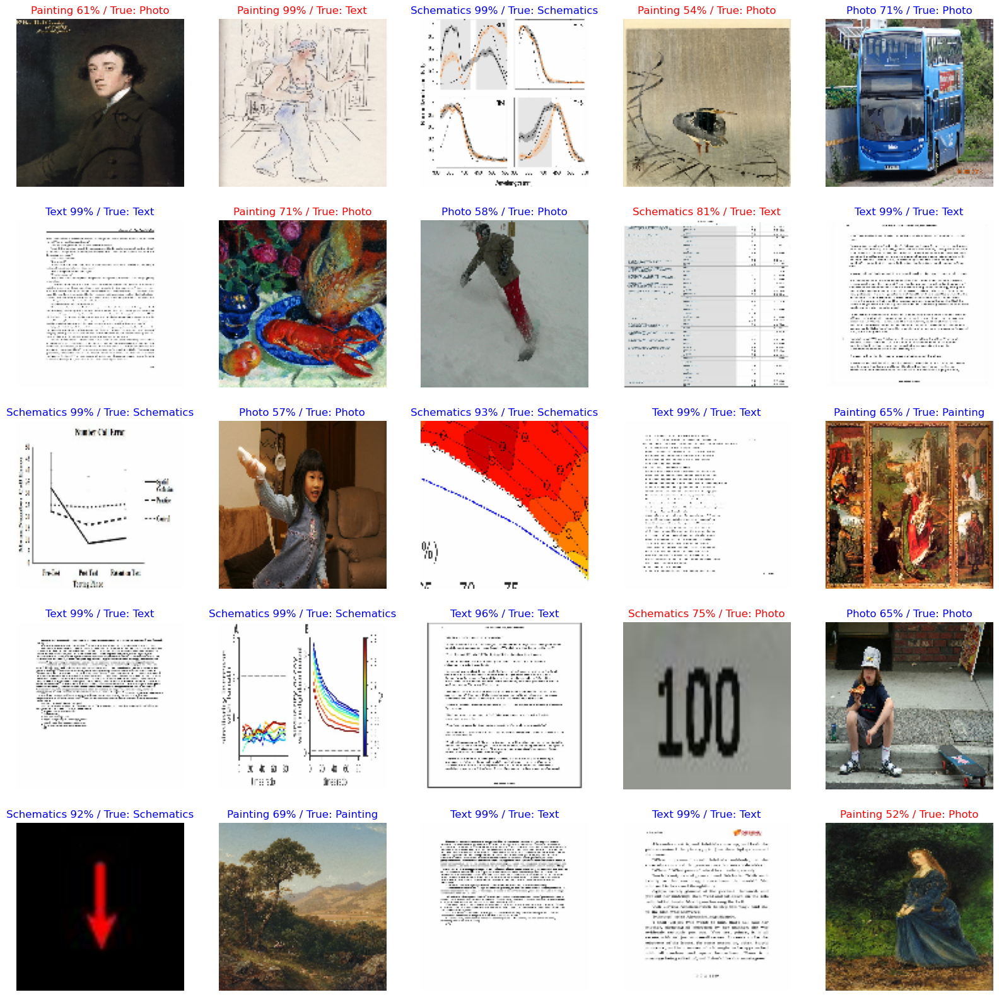

In [34]:
image_batch, label_batch = test_set.as_numpy_iterator().next()

predictions = best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)


print("Labels: ", label_batch)
print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    label = label_batch[i]
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if predicted_label == label else "red"

    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)
    plt.title("{} {}% / True: {}".format(class_names[label],
              int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


Le code charge un modèle enregistré précédemment à partir du répertoire spécifié par saved_model_dir et le stocke dans la variable saved_best_model. Ce modèle sera utilisé pour prédire les classes de nouvelles images dans le répertoire spécifié par data_set_to_classify_dir.





In [35]:
data_set_to_classify_dir = os.path.join("test")
# saved_model_dir = "models_best_fit/model_multiclass_CNN.h5"
saved_model_dir = models_dir

saved_best_model = tf.keras.models.load_model(saved_model_dir)

Le code ci-dessus crée un dataset à partir du répertoire spécifié dans data_set_to_classify_dir. Le dataset est créé en lisant toutes les images de ce répertoire et en les redimensionnant à la taille spécifiée dans image_size (128x128 dans ce cas). Le dataset est également mélangé aléatoirement et divisé en lots de taille batch_size (32 dans ce cas). Le dataset est prêt à être utilisé pour classifier les images contenues dans le répertoire spécifié.





In [36]:
test_final_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    data_set_to_classify_dir,
    shuffle=True,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    ) 

Found 148 files belonging to 1 classes.


Ce code permet de prédire la classe de chaque image contenue dans le jeu de données test_final_dataset. Pour chaque image, une prédiction est faite en utilisant le modèle saved_best_model, et la classe prédite est obtenue en trouvant l'indice de la colonne ayant la valeur la plus élevée dans la matrice de prédictions normalisée predictions_normalized. Les prédictions sont affichées dans une figure avec leur probabilité d'appartenance à la classe prédite. Si la probabilité est supérieure à 50%, la couleur du titre est bleue, sinon elle est rouge.





1/1 [==============================] - 0s 83ms/step
Predicted labels:  [1 1 1 1 1 1 2 1 1 1 1 1 1 1 1 1 1 1 1 1 0 1 1 1 1 1 1 1 1 1 1 1]


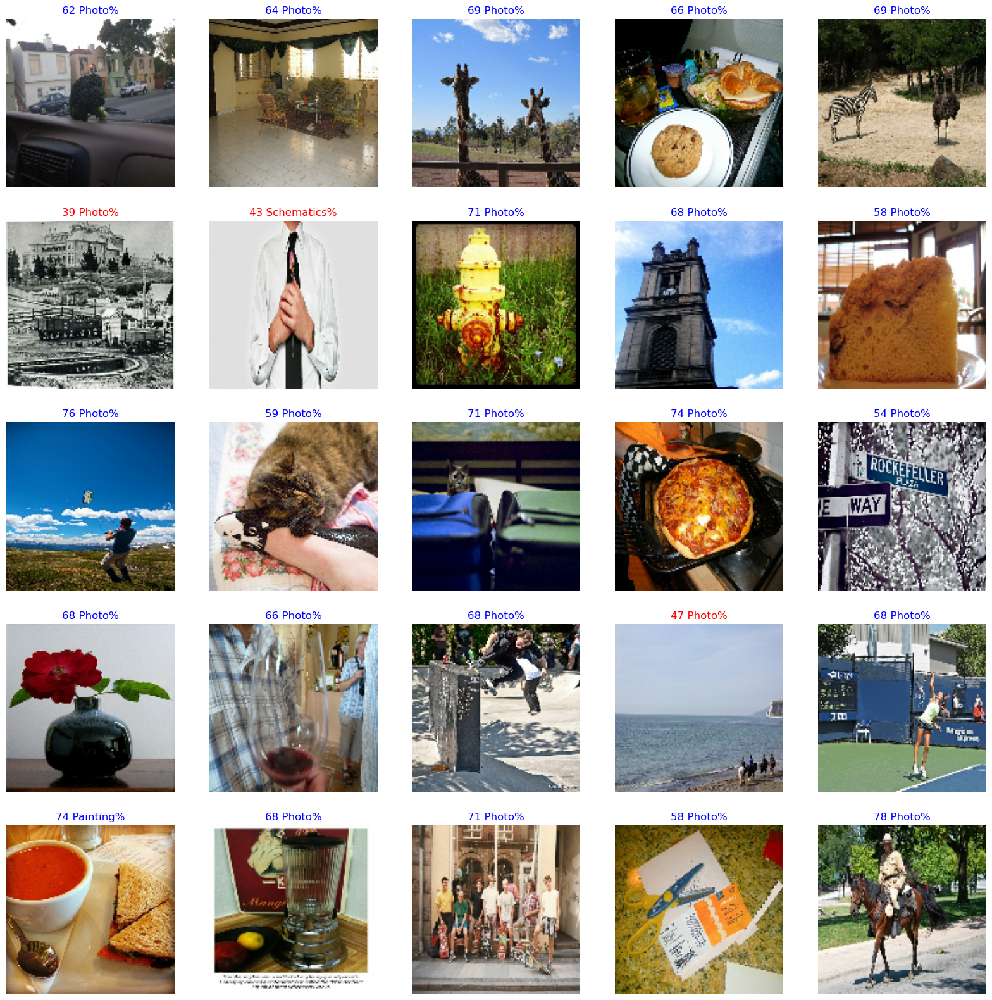

In [37]:
image_batch, label_batch = test_final_dataset.as_numpy_iterator().next()

predictions = saved_best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)

print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if int(predicted_prob*100) > 50 else "red"


    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)

    plt.title("{} {}%".format(int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


# Creation d'un hypermodèle 

Ce code définit une fonction hyper_model_builder qui construit un modèle de réseau de neurones convolutionnel (CNN) en utilisant les hyperparamètres spécifiés en entrée. Le modèle commence par ajouter une couche d'entrée qui prend en charge les images de taille (IMG_H, IMG_W, 3). La couche suivante est une couche de normalisation qui normalise les valeurs des pixels de l'image. Ensuite, le modèle ajoute une couche de convolution avec 32 filtres de 3x3 avec une fonction d'activation ReLU, suivie d'une couche de max pooling de 2x2. Ensuite, le modèle aplatit les données à l'aide de la couche Flatten().

Le modèle ajoute une couche dense avec un nombre d'unités spécifié en utilisant l'hyperparamètre hp_units. L'hyperparamètre hp_units peut prendre des valeurs entières allant de 128 à 512 par pas de 16. Le modèle ajoute également une couche de dropout avec un taux de dropout spécifié en utilisant l'hyperparamètre hp_dropout. L'hyperparamètre hp_dropout peut prendre des valeurs de flottant allant de 0.0 à 0.5 par pas de 0.1. Enfin, le modèle ajoute une couche de sortie de dimensions NUM_CLASSES.

Le modèle est compilé en utilisant la fonction compile de Keras avec une perte de catégorie croisée de sparsity et une mesure de précision en tant que métrique d'évaluation.
Le modèle utilise l'optimiseur Adam avec un taux d'apprentissage variable qui sera sélectionné par hyperparamètre. Le modèle comprend également deux couches de densité avec un taux de dropout variable qui sera également sélectionné par hyperparamètre. La première couche de densité a également une variable de nombre d'unités qui sera sélectionnée par hyperparamètre. La dernière couche du modèle est une couche de sortie avec autant de sorties que de classes de label.



In [17]:
def hyper_model_builder(hyper_parameter):
    model = tf.keras.Sequential()

    model.add(tf.keras.Input(shape=(IMG_H, IMG_W, 3)))
    model.add(normalization_layer)
    # model.add(data_augmentation)

    model.add(tf.keras.layers.Conv2D(
        filters=32,
        kernel_size=3,
        strides=1,
        padding='same',
        activation='relu',
    )),
    model.add(tf.keras.layers.MaxPooling2D((2, 2))),
    model.add(tf.keras.layers.Flatten())

    # Tune the number of units in the first Dense layer
    # Choose an optimal value between 128-512
    hp_units = hyper_parameter.Int(
        'units', min_value=128, max_value=512, step=16)
    hp_dropout = hyper_parameter.Float(
        'dropout', min_value=0.0, max_value=0.5, step=0.1)

    model.add(tf.keras.layers.Dense(units=hp_units, activation='relu'))
    model.add(tf.keras.layers.Dropout(rate=hp_dropout))

    model.add(tf.keras.layers.Dense(NUM_CLASSES))

    # Tune the learning rate for the optimizer
    # Choose an optimal value from 0.01, 0.001, or 0.0001
    hp_learning_rate = hyper_parameter.Choice(
        'learning_rate', values=[1e-2, 1e-3, 1e-4])

    model.compile(
        optimizer=tf.keras.optimizers.Adam(learning_rate=hp_learning_rate),
        loss=keras.losses.SparseCategoricalCrossentropy(from_logits=True),
        metrics=['accuracy']
    )

    return model


MAX_EPOCHS est le nombre maximum d'époques que le modèle peut être entraîné pendant le processus de recherche hyperparamétrique. FACTOR est un facteur de multiplication utilisé pour déterminer combien de modèles à chaque étape de l'algorithme Hyperband doivent être entraînés. Tuner est une instance de l'algorithme Hyperband qui recherche les hyperparamètres optimaux en utilisant la fonction hyper_model_builder qui construit le modèle, l'objectif 'val_accuracy' qui indique que nous voulons maximiser l'accuracy de validation pendant la recherche hyperparamétrique, et en enregistrant les résultats de la recherche dans le répertoire 'tuning' avec un nom de projet 'hypermodel_multiclass_CNN'.





In [18]:
MAX_EPOCHS=20
FACTOR=3

tuner = kt.Hyperband(
    hyper_model_builder,
    objective='val_accuracy',
    max_epochs=MAX_EPOCHS,
    factor=FACTOR,
    directory='tuning',
    project_name='hypermodel_multiclass_CNN'
)

In [19]:
models_dir = 'models/' + datetime.datetime.now().strftime("%Y%m%d-%H%M%S") + '/' + 'hypermodel.h5'
logs_dir = "logs/" + datetime.datetime.now().strftime("%Y%m%d-%H%M%S")

stop_early = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=5, verbose=1, mode='auto')
model_checkpoint = tf.keras.callbacks.ModelCheckpoint(models_dir, monitor='val_loss', verbose=1, save_best_only=True, mode='auto')
tensorboard_callback = tf.keras.callbacks.TensorBoard(log_dir=logs_dir, histogram_freq=1)

Le modèle est compilé en utilisant les hyperparamètres choisis pour le modèle de réseau de neurones convolutionnel. Le modèle est entraîné sur l'ensemble de données d'entraînement en utilisant le mécanisme de recherche d'hyperparamètres Hyperband. Les hyperparamètres incluent le nombre d'unités dans la première couche dense, le taux de dropout et le taux d'apprentissage. Le modèle est arrêté prématurément et le meilleur modèle est enregistré au cours de l'entraînement en fonction de la précision de la validation. Les meilleurs hyperparamètres sont affichés à la fin de l'entraînement.





In [20]:
# Exécutez la recherche d'hyperparamètres

img_train, label_train = train_set.as_numpy_iterator().next()

tuner.search(
    img_train, label_train,
    epochs=50,
    validation_split=0.2,
    callbacks=[stop_early, model_checkpoint, tensorboard_callback]
)

# Afficher les meilleurs hyperparamètres
best_hps = tuner.get_best_hyperparameters(num_trials=1)[0]


Trial 2 Complete [00h 02m 12s]
val_accuracy: 0.7142857313156128

Best val_accuracy So Far: 0.7142857313156128
Total elapsed time: 00h 02m 52s

Search: Running Trial #3

Value             |Best Value So Far |Hyperparameter
496               |304               |units
0.2               |0.4               |dropout
0.0001            |0.001             |learning_rate
3                 |3                 |tuner/epochs
0                 |0                 |tuner/initial_epoch
2                 |2                 |tuner/bracket
0                 |0                 |tuner/round

Epoch 1/3
1/1 [==============================] - ETA: 0s - loss: 1.6374 - accuracy: 0.3200
Epoch 1: val_loss improved from inf to 3.43441, saving model to models/20230106-231445\hypermodel.h5
1/1 [==============================] - 128s 128s/step - loss: 1.6374 - accuracy: 0.3200 - val_loss: 3.4344 - val_accuracy: 0.2857
Epoch 2/3
1/1 [==============================] - ETA: 0s - loss: 2.7131 - accuracy: 0.2800
Epoch 2: va

KeyboardInterrupt: 

In [53]:
print(f"""
The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is {best_hps.get('units')} and the optimal learning rate for the optimizer
is {best_hps.get('learning_rate')}. and the optimal dropout rate for the Dropout layer
is {best_hps.get('dropout')}.
""")


The hyperparameter search is complete. The optimal number of units in the first densely-connected
layer is 432 and the optimal learning rate for the optimizer
is 0.01. and the optimal dropout rate for the Dropout layer
is 0.5. and the optimal number of units in the second densely-connected
layer is 224 and the optimal dropout rate for the Dropout layer
is 0.5.
is 0.5.



In [54]:
hypermodel = tuner.hypermodel.build(best_hps)

hypermodel.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 sequential_3 (Sequential)   (None, 128, 128, 3)       0         
                                                                 
 sequential (Sequential)     (None, 128, 128, 3)       0         
                                                                 
 conv2d_3 (Conv2D)           (None, 128, 128, 32)      896       
                                                                 
 max_pooling2d_3 (MaxPooling  (None, 64, 64, 32)       0         
 2D)                                                             
                                                                 
 conv2d_4 (Conv2D)           (None, 64, 64, 64)        18496     
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 32, 32, 64)       0         
 2D)                                                  

La fonction hypermodel.fit entraîne le modèle sur les données de l'ensemble d'entraînement avec les hyperparamètres définis dans hyper_model_builder. L'historique de l'entraînement du modèle est enregistré dans hp_hist. La variable stop_early est un callback qui permet d'arrêter l'entraînement prématurément si la performance du modèle sur les données de validation ne s'améliore pas. model_checkpoint est un autre callback qui enregistre les poids du modèle lorsque la performance sur les données de validation est meilleure. tensorboard_callback est un autre callback qui enregistre les métriques d'entraînement et de validation dans TensorBoard pour faciliter l'analyse. La variable val_acc_per_epoch contient la liste des taux de précision de validation pour chaque époque. La variable best_epoch est l'époque avec le taux de précision de validation le plus élevé.





In [55]:
hp_hist = hypermodel.fit(
    train_set,
    epochs=50,
    validation_data=val_set,
    callbacks=[stop_early, model_checkpoint, tensorboard_callback]
)

val_acc_per_epoch = hp_hist.history['val_accuracy']
best_epoch = val_acc_per_epoch.index(max(val_acc_per_epoch)) + 1
print('Best epoch: %d' % (best_epoch,))

Epoch 1/50
1017/1017 [==============================] - ETA: 0s - loss: 1.4649 - accuracy: 0.4941
Epoch 1: val_loss improved from inf to 0.94262, saving model to models/20230106-172113\hypermodel.h5
1017/1017 [==============================] - 242s 235ms/step - loss: 1.4649 - accuracy: 0.4941 - val_loss: 0.9426 - val_accuracy: 0.5623
Epoch 2/50
1017/1017 [==============================] - ETA: 0s - loss: 1.0249 - accuracy: 0.5180
Epoch 2: val_loss did not improve from 0.94262
1017/1017 [==============================] - 205s 201ms/step - loss: 1.0249 - accuracy: 0.5180 - val_loss: 1.0420 - val_accuracy: 0.5272
Epoch 3/50
1017/1017 [==============================] - ETA: 0s - loss: 1.0120 - accuracy: 0.5169
Epoch 3: val_loss did not improve from 0.94262
1017/1017 [==============================] - 195s 191ms/step - loss: 1.0120 - accuracy: 0.5169 - val_loss: 1.0116 - val_accuracy: 0.5312
Epoch 4/50
1017/1017 [==============================] - ETA: 0s - loss: 1.0237 - accuracy: 0.5091
Ep

In [56]:
hypermodel = tuner.hypermodel.build(best_hps)

# Retrain the model
hp_hist = hypermodel.fit(train_set,
               epochs=best_epoch,
               validation_data=val_set,
               callbacks=[stop_early, model_checkpoint, tensorboard_callback])


1017/1017 [==============================] - ETA: 0s - loss: 1.2095 - accuracy: 0.4725
Epoch 1: val_loss did not improve from 0.94262
1017/1017 [==============================] - 199s 193ms/step - loss: 1.2095 - accuracy: 0.4725 - val_loss: 0.9750 - val_accuracy: 0.5240


In [57]:
eval_result = hypermodel.evaluate(test_set)
print("[test loss, test accuracy]:", eval_result)

51/51 [==============================] - 2s 34ms/step - loss: 0.9999 - accuracy: 0.4871
[test loss, test accuracy]: [0.999886691570282, 0.48713234066963196]


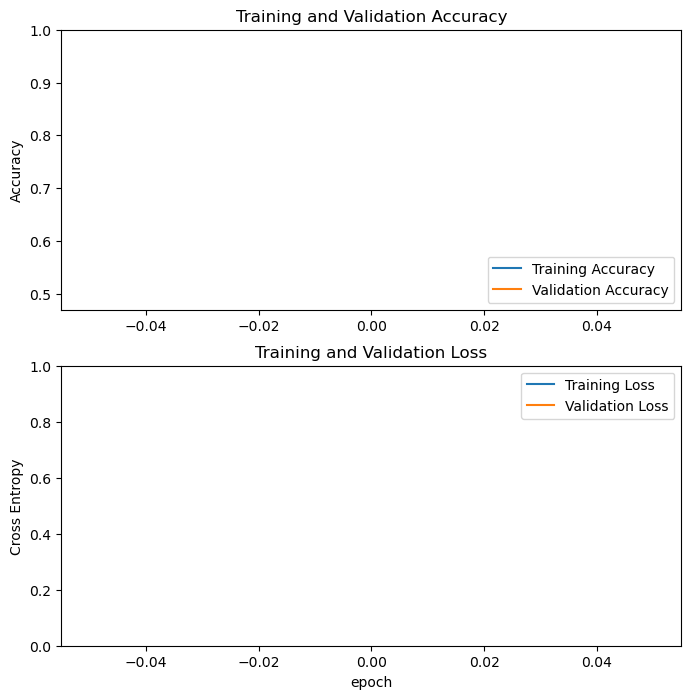

In [58]:
acc = hp_hist.history['accuracy']
val_acc = hp_hist.history['val_accuracy']

loss = hp_hist.history['loss']
val_loss = hp_hist.history['val_loss']

plt.figure(figsize=(8, 8))
plt.subplot(2, 1, 1)
plt.plot(acc, label='Training Accuracy')
plt.plot(val_acc, label='Validation Accuracy')
plt.legend(loc='lower right')
plt.ylabel('Accuracy')
plt.ylim([min(plt.ylim()),1])
plt.title('Training and Validation Accuracy')

plt.subplot(2, 1, 2)
plt.plot(loss, label='Training Loss')
plt.plot(val_loss, label='Validation Loss')
plt.legend(loc='upper right')
plt.ylabel('Cross Entropy')
plt.ylim([0,1.0])
plt.title('Training and Validation Loss')
plt.xlabel('epoch')
plt.show()

1/1 [==============================] - 0s 92ms/step
Labels:  [0 0 2 0 1 4 0 1 2 4 2 1 2 4 0 4 2 4 2 1 2 0 4 4 0 0 0 0 0 2 0 2]
Predicted labels:  [1 2 4 1 1 4 1 1 4 4 4 1 1 4 1 4 4 4 1 1 1 1 4 4 1 1 1 1 1 2 1 1]


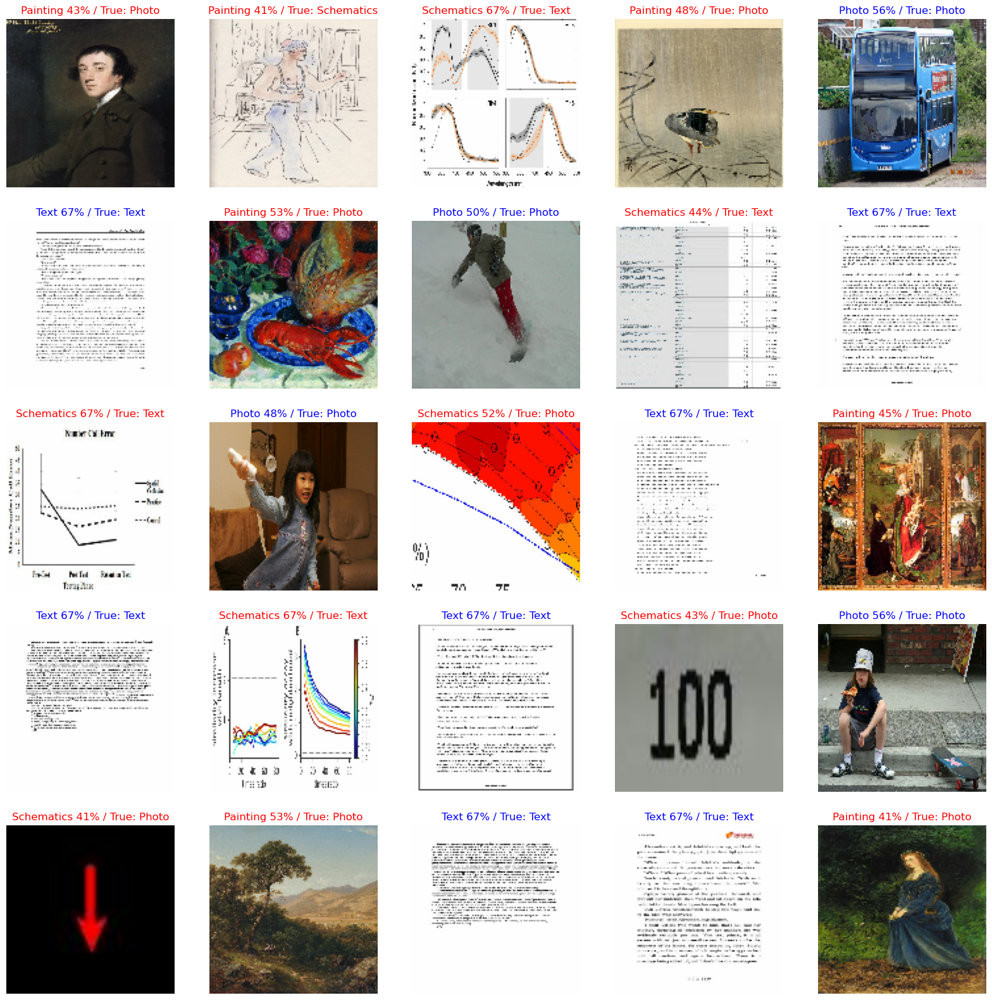

In [59]:
image_batch, label_batch = test_set.as_numpy_iterator().next()

predictions = hypermodel.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)


print("Labels: ", label_batch)
print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    label = label_batch[i]
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if predicted_label == label else "red"

    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)
    plt.title("{} {}% / True: {}".format(class_names[label],
              int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


In [60]:
# load the best model
best_model = tf.keras.models.load_model(models_dir)

# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = best_model.evaluate(test_set, batch_size=128)
print("test loss, test acc:", results)

Evaluate on test data
51/51 [==============================] - 1s 10ms/step - loss: 0.9749 - accuracy: 0.5294
test loss, test acc: [0.9749002456665039, 0.529411792755127]


1/1 [==============================] - 0s 77ms/step
Labels:  [0 0 2 0 1 4 0 1 2 4 2 1 2 4 0 4 2 4 2 1 2 0 4 4 0 0 0 0 0 2 0 2]
Predicted labels:  [1 2 4 1 1 4 1 1 4 4 4 1 1 4 1 4 2 4 1 1 1 1 4 4 1 1 1 1 1 2 1 1]


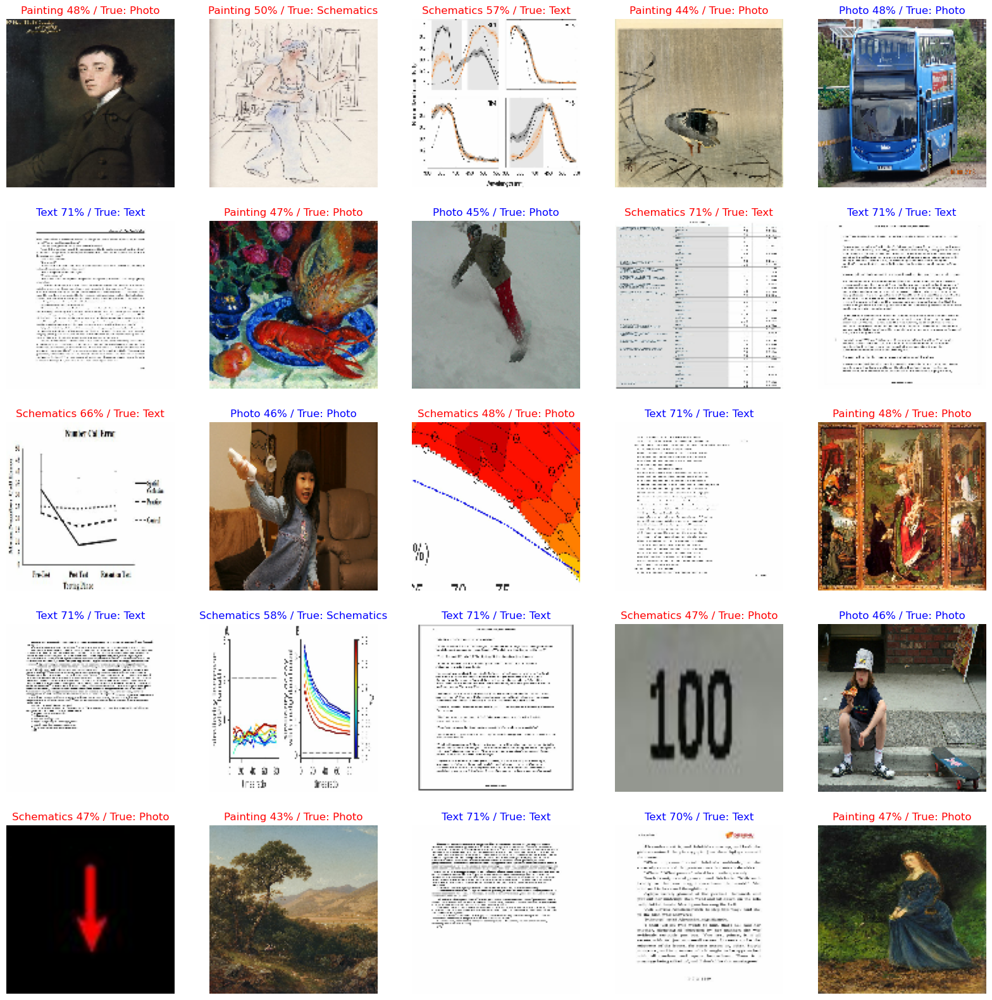

In [61]:
image_batch, label_batch = test_set.as_numpy_iterator().next()

predictions = best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)


print("Labels: ", label_batch)
print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    label = label_batch[i]
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if predicted_label == label else "red"

    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)
    plt.title("{} {}% / True: {}".format(class_names[label],
              int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


In [56]:
data_set_to_classify_dir = os.path.join("test")
saved_model_dir = models_dir


saved_best_model = tf.keras.models.load_model(saved_model_dir)

NameError: name 'models_dir' is not defined

In [63]:
test_final_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    data_set_to_classify_dir,
    shuffle=True,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    ) 

Found 148 files belonging to 1 classes.


1/1 [==============================] - 0s 75ms/step
Predicted labels:  [1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1 1]


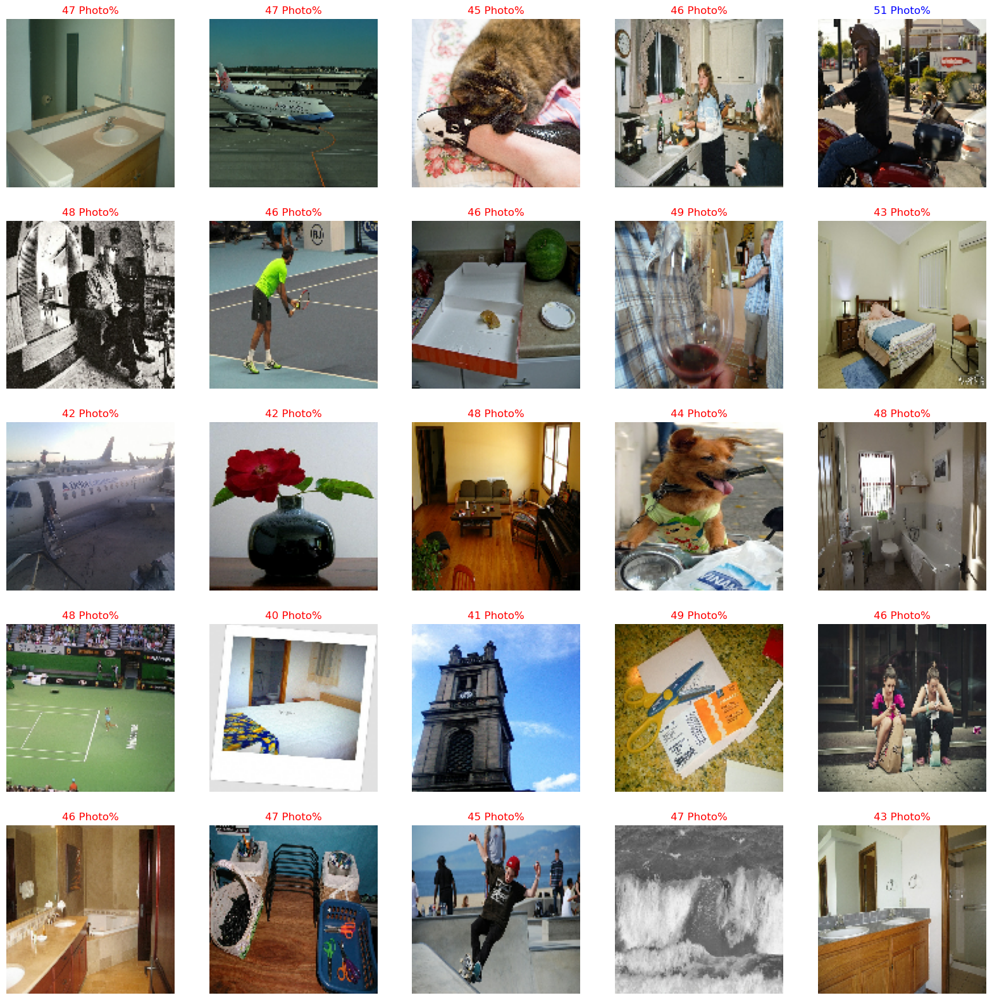

In [64]:
image_batch, label_batch = test_final_dataset.as_numpy_iterator().next()

predictions = saved_best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)

print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if int(predicted_prob*100) > 50 else "red"


    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)

    plt.title("{} {}%".format(int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")


# Essayer ici notre meilleur modèle !

Le model que vous avez vu précedement ne converge pas encore a la perfection , on est toujours entrain d'essayer d'avoir de meilleurs résulats mais vous pouvez essayer ici notre meilleur model pour le moment

In [79]:
data_set_to_classify_dir = os.path.join("test") # importer ici le dossier contenant les images à classifier (a noter que le dossier doit contenir un sous dossier par classe)
saved_model_dir = "models/20230106-130619/hypermodel.h5" # importer ici le chemin du modèle sauvegardé (utiliser celui qu'on vous a fourni)

saved_best_model = tf.keras.models.load_model(saved_model_dir)

In [80]:
# Evaluate the model on the test data using `evaluate`
print("Evaluate on test data")
results = saved_best_model.evaluate(test_set, batch_size=128)
print("test loss, test acc:", results)

Evaluate on test data
51/51 [==============================] - 3s 43ms/step - loss: 0.2158 - accuracy: 0.9124
test loss, test acc: [0.21575698256492615, 0.9123774766921997]


In [83]:
saved_best_model.summary()

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 rescaling_1 (Rescaling)     (None, 128, 128, 3)       0         
                                                                 
 conv2d_4 (Conv2D)           (None, 128, 128, 16)      448       
                                                                 
 max_pooling2d_4 (MaxPooling  (None, 64, 64, 16)       0         
 2D)                                                             
                                                                 
 conv2d_5 (Conv2D)           (None, 64, 64, 32)        4640      
                                                                 
 max_pooling2d_5 (MaxPooling  (None, 32, 32, 32)       0         
 2D)                                                             
                                                                 
 conv2d_6 (Conv2D)           (None, 32, 32, 64)       

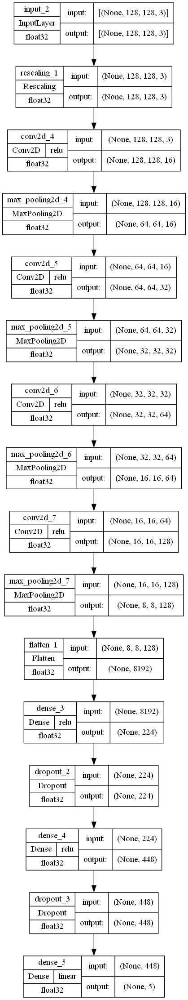

In [84]:
schema_file = "architecture/model_CNN_multiclass.png"
 
tf.keras.utils.plot_model(
    saved_best_model,
    to_file=schema_file,
    show_shapes=True,
    show_dtype=True,
    show_layer_names=True,
    rankdir='TB',
    expand_nested=True,
    dpi=96,
    layer_range=None,
    show_layer_activations=True
)

(-0.5, 881.5, 809.5, -0.5)

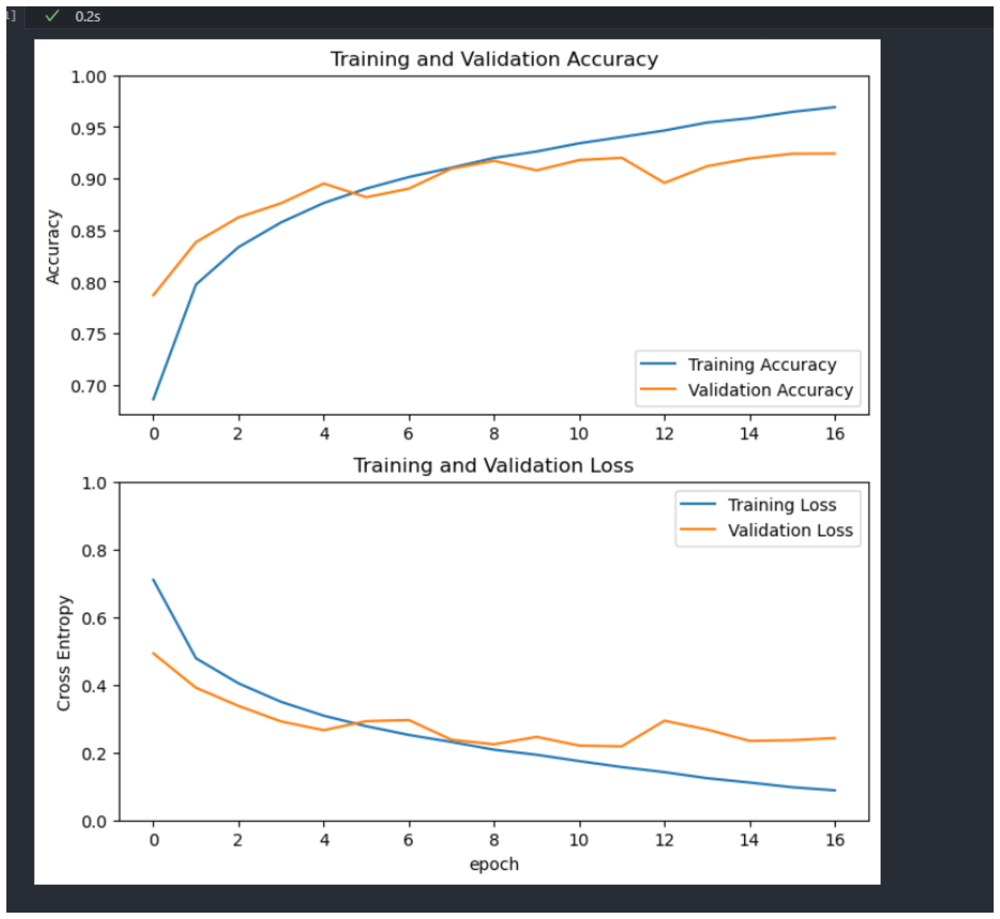

In [85]:
# Ce code permet de visualiser l'évolution de l'accuracy et de la loss du meilleur modèle obtenu jusqu'a maintenant pendant l'entraînement et la validation. 
# Le modèle est entraîné sur un jeu de données d'entraînement et évalué sur un jeu de données de validation.

img = 'courbes_apprentissage/324218233_425225196414713_3895010035611558934_n.png'

plt.figure(figsize=(20, 20))
plt.imshow(plt.imread(img))
plt.axis("off")

In [81]:
test_final_dataset = tf.keras.preprocessing.image_dataset_from_directory(
    data_set_to_classify_dir,
    shuffle=True,
    image_size=(IMG_H, IMG_W),
    batch_size=BATCH_SIZE,
    ) 

Found 148 files belonging to 1 classes.


1/1 [==============================] - 0s 100ms/step
Predicted labels:  [1 1 1 1 1 1 1 0 1 1 1 0 0 1 0 1 1 1 0 1 1 1 0 1 1 1 1 1 1 1 1 1]


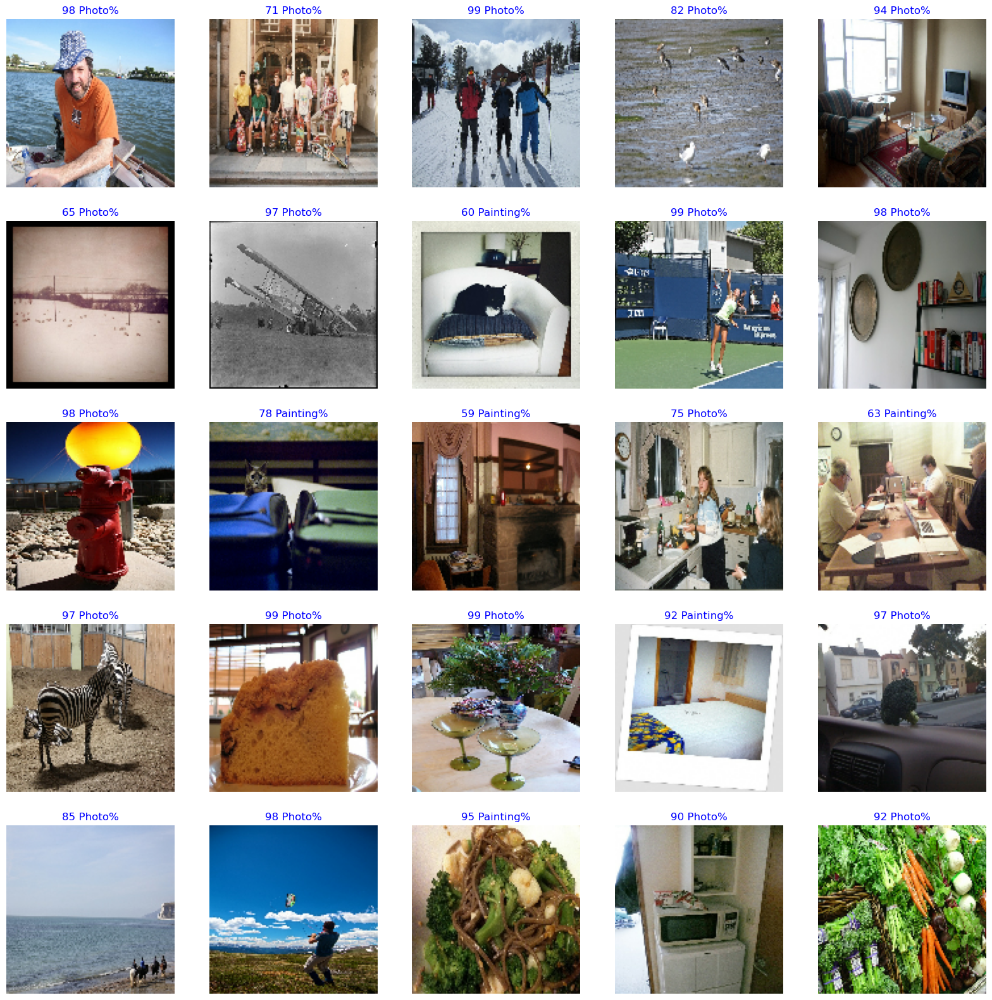

In [82]:
image_batch, label_batch = test_final_dataset.as_numpy_iterator().next()

predictions = saved_best_model.predict(image_batch)

predicted_ids = np.argmax(predictions, axis=-1)

predictions_normalized = tf.nn.softmax(predictions)

print("Predicted labels: ", predicted_ids)

plt.figure(figsize=(20, 20))
for i in range(25):

    image = image_batch[i].astype("uint8")
    predicted_label = predicted_ids[i]
    predicted_prob = np.max(predictions_normalized[i])
    color = "blue" if int(predicted_prob*100) > 50 else "red"


    ax = plt.subplot(5, 5, i + 1)
    plt.imshow(image)

    plt.title("{} {}%".format(int(predicted_prob*100), class_names[predicted_label]), color=color)
    plt.axis("off")
